<a href="https://colab.research.google.com/github/Imshyeon/2023_AI_BACKEND_AI/blob/master/Object%20Detection/YOLO/Ultralytics_YOLO_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
!nvidia-smi

Thu Oct 19 01:42:22 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
!pwd

/content


In [8]:
!git clone "https://github.com/ultralytics/yolov3"

Cloning into 'yolov3'...
remote: Enumerating objects: 10911, done.
remote: Counting objects: 100% (833/833), done.
remote: Compressing objects: 100% (389/389), done.
remote: Total 10911 (delta 569), reused 669 (delta 443), pack-reused 10078
Receiving objects: 100% (10911/10911), 9.85 MiB | 25.23 MiB/s, done.
Resolving deltas: 100% (7368/7368), done.


In [9]:
!ls -l

total 8
drwxr-xr-x 1 root root 4096 Oct 17 13:25 sample_data
drwxr-xr-x 9 root root 4096 Oct 19 01:43 yolov3


In [10]:
%cd yolov3

/content/yolov3


In [11]:
!pwd

/content/yolov3


In [12]:
!cat requirements.txt

# YOLOv3 requirements
# Usage: pip install -r requirements.txt

# Base ------------------------------------------------------------------------
gitpython>=3.1.30
matplotlib>=3.3
numpy>=1.22.2
opencv-python>=4.1.1
Pillow>=7.1.2
psutil  # system resources
PyYAML>=5.3.1
requests>=2.23.0
scipy>=1.4.1
thop>=0.1.1  # FLOPs computation
torch>=1.8.0  # see https://pytorch.org/get-started/locally (recommended)
torchvision>=0.9.0
tqdm>=4.64.0
ultralytics>=8.0.147
# protobuf<=3.20.1  # https://github.com/ultralytics/yolov5/issues/8012

# Logging ---------------------------------------------------------------------
# tensorboard>=2.4.1
# clearml>=1.2.0
# comet

# Plotting --------------------------------------------------------------------
pandas>=1.1.4
seaborn>=0.11.0

# Export ----------------------------------------------------------------------
# coremltools>=6.0  # CoreML export
# onnx>=1.10.0  # ONNX export
# onnx-simplifier>=0.4.1  # ONNX simplifier
# nvidia-pyindex  # TensorRT export
# nvi

In [13]:
!pip install -qr requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 3.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.5/644.5 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.5 MB/s eta 0:00:00


In [15]:
import torch

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Setup complete. Using torch 2.0.1+cu118 (Tesla T4)


# Image Detection

In [16]:
!ls -l data/images

total 648
-rw-r--r-- 1 root root 487438 Oct 19 01:43 bus.jpg
-rw-r--r-- 1 root root 168949 Oct 19 01:43 zidane.jpg


In [19]:
!python detect.py --weights yolov3.pt --img 640 --conf 0.25 --source data/images --exist-ok --line-thickness 2

detect: weights=['yolov3.pt'], source=data/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=True, line_thickness=2, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv3 🚀 v9.6.0-116-g0252bec Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

100% 119M/119M [00:01<00:00, 67.1MB/s]

Fusing layers... 
yolov3 summary: 261 layers, 61922845 parameters, 0 gradients
image 1/2 /content/yolov3/data/images/bus.jpg: 640x480 4 persons, 1 bicycle, 1 bus, 63.2ms
image 2/2 /content/yolov3/data/images/zidane.jpg: 384x640 2 persons, 2 ties, 64.4ms
Speed: 0.7ms pre-process, 63.8ms inference, 167.6ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp


In [20]:
!ls -l runs/detect/exp

total 728
-rw-r--r-- 1 root root 494073 Oct 19 01:47 bus.jpg
-rw-r--r-- 1 root root 249539 Oct 19 01:47 zidane.jpg


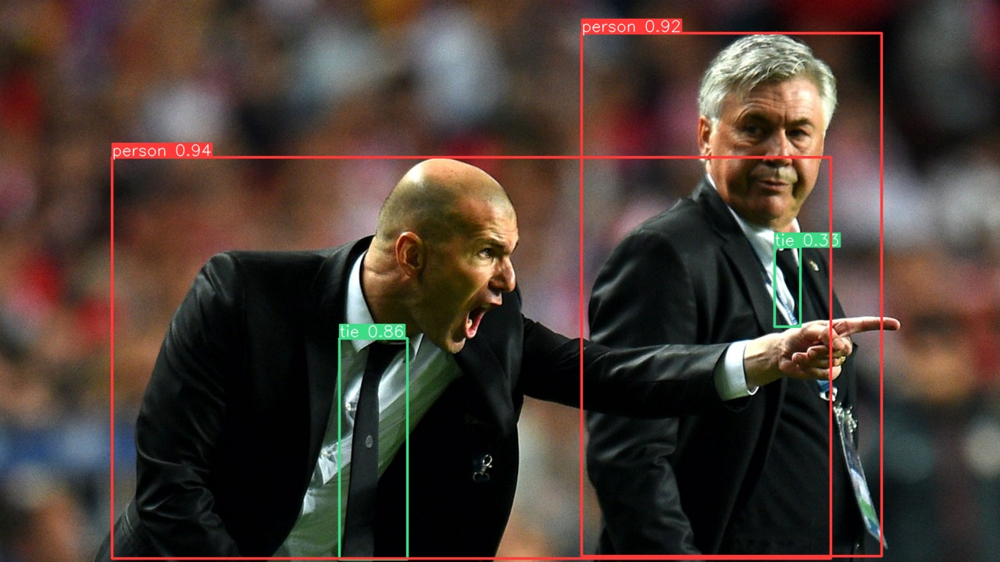

In [21]:
from IPython.display import Image,clear_output

Image(filename = 'runs/detect/exp/zidane.jpg')

# 추가 Image Detection

In [22]:
!pwd

/content/yolov3


In [23]:
!wget https://raw.githubusercontent.com/rusita-ai/pyData/master/image/KIA.jpg

--2023-10-19 01:48:26--  https://raw.githubusercontent.com/rusita-ai/pyData/master/image/KIA.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 65805 (64K) [image/jpeg]
Saving to: ‘KIA.jpg’

KIA.jpg             100%[===================>]  64.26K  --.-KB/s    in 0.01s   

2023-10-19 01:48:26 (4.78 MB/s) - ‘KIA.jpg’ saved [65805/65805]



In [24]:
!ls -l KIA.jpg

-rw-r--r-- 1 root root 65805 Oct 19 01:48 KIA.jpg


In [25]:
!python detect.py --weights yolov3.pt --img 640 --conf 0.25 --source /content/yolov3/KIA.jpg --project /content/data --name=run_image --exist-ok --line-thickness 1

detect: weights=['yolov3.pt'], source=/content/yolov3/KIA.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=/content/data, name=run_image, exist_ok=True, line_thickness=1, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv3 🚀 v9.6.0-116-g0252bec Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
yolov3 summary: 261 layers, 61922845 parameters, 0 gradients
image 1/1 /content/yolov3/KIA.jpg: 480x640 4 persons, 1 car, 52.8ms
Speed: 0.5ms pre-process, 52.8ms inference, 98.5ms NMS per image at shape (1, 3, 640, 640)
Results saved to /content/data/run_image


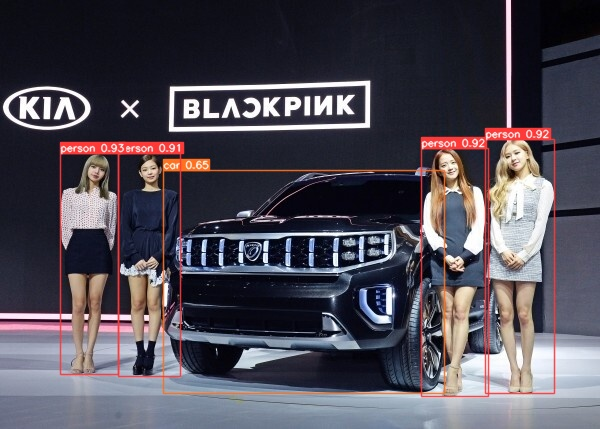

In [26]:
Image(filename = '/content/data/run_image/KIA.jpg')

In [27]:
!python detect.py --weights yolov3-tiny.pt --img 640 --img 640 --conf 0.25 --source /content/yolov3/KIA.jpg --project /content/data --name=run_tiny --exist-ok --line-thickness 1

detect: weights=['yolov3-tiny.pt'], source=/content/yolov3/KIA.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=/content/data, name=run_tiny, exist_ok=True, line_thickness=1, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv3 🚀 v9.6.0-116-g0252bec Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)

100% 17.0M/17.0M [00:00<00:00, 34.4MB/s]

Fusing layers... 
yolov3-tiny summary: 48 layers, 8849182 parameters, 0 gradients
image 1/1 /content/yolov3/KIA.jpg: 480x640 4 persons, 33.2ms
Speed: 0.6ms pre-process, 33.2ms inference, 98.1ms NMS per image at shape (1, 3, 640, 640)
Results saved to /content/data/run_tiny


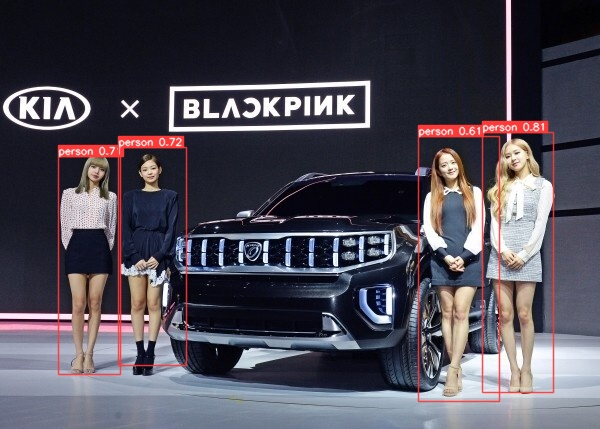

In [29]:
Image(filename = '/content/data/run_tiny/KIA.jpg')

# Video Detection

In [30]:
!wget https://raw.githubusercontent.com/rusita-ai/pyData/master/image/Matrix2.mp4

--2023-10-19 01:52:31--  https://raw.githubusercontent.com/rusita-ai/pyData/master/image/Matrix2.mp4
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 17873420 (17M) [application/octet-stream]
Saving to: ‘Matrix2.mp4’

Matrix2.mp4         100%[===================>]  17.04M  --.-KB/s    in 0.08s   

2023-10-19 01:52:31 (220 MB/s) - ‘Matrix2.mp4’ saved [17873420/17873420]



In [32]:
import io
import base64
from IPython.display import HTML

video = io.open('/content/yolov3/Matrix2.mp4', 'r+b').read()

encoded = base64.b64encode(video)

HTML(data='''<video width="70%" controls>
              <source src="data:video/mp5;base64,{0}" type="video/mp4" />
            </video>'''.format(encoded.decode('ascii')))

In [33]:
%%time

!python detect.py --weights yolov3.pt --img 640 --img 640 --conf 0.25 --source /content/yolov3/Matrix2.mp4 --project /content/data --name=run_video --exist-ok --line-thickness 2

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
video 1/1 (3265/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 27.2ms
video 1/1 (3266/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 27.3ms
video 1/1 (3267/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 25.3ms
video 1/1 (3268/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 26.7ms
video 1/1 (3269/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 26.4ms
video 1/1 (3270/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 27.4ms
video 1/1 (3271/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 25.8ms
video 1/1 (3272/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 26.8ms
video 1/1 (3273/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 27.6ms
video 1/1 (3274/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 26.8ms
video 1/1 (3275/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 25.2ms
video 1/1 (3276/8260) /content/yolov3/Matrix2.mp4: 384x640 1 person, 26.8ms
video 1/1 (3277/8260) /content/yolov3/Matrix2.mp4: 3